In [1]:
include("../src/Conduction.jl");
using Plots, LaTeXStrings, QuadGK;

semiconductor = Conduction.Semiconductor(
4.34e7, # decay constant of the assumed hydrogen-like localized state wave functions (cm^-1)
0.1 * 1.6e-19, # Mode effect of the phonons (J)
3e21, # intrinsic semiconductor's density (cm^-3)
0, # Doping states' density (cm^-3)
0.1 * 1.6e-19, # Energy to a vacant target site (J)
-5.3e4, # Field (V.cm^-1)
1e13, # Base electron jump rate
-27, # Fermi level (J)
2.74, # Intrinsic semiconductor's gaussian width (J)
2.7, # Doping states' gaussian width (J)
2.7, # Amount of disorder
150e-7
);

T = 300;

We investigate the influence of the lower limit of $0.05eV$ for the classic gaussian DOS.

In [2]:
kp_lower_limit(semiconductor, T, x) =  quadgk(
    r -> Conduction.k * T * Conduction.DOSp(semiconductor, r, T) * Conduction.C(r, T) * Conduction.Dp(semiconductor, r, T),
    x,
    +Inf
)[1]

kp_lower_limit(semiconductor, T, 8.01e-21 / (Conduction.k * T))

4.503264123974021e-13

Like before, the overall thermal diffusion is too low.

To understand better the influence of the parameter, we will compute $k$ for different $\omega_\alpha$ values.

In [3]:
function test_omega_alpha(range)
    res = [];
    for i in range
        semiconductor.ModeEffect = i;
        append!(res, kp_lower_limit(semiconductor, T, 8.01e-21 / (Conduction.k * T)));
    end

    return res
end

range = (0.00001:0.00001:1) * 1.6e-19;
res = test_omega_alpha(range);

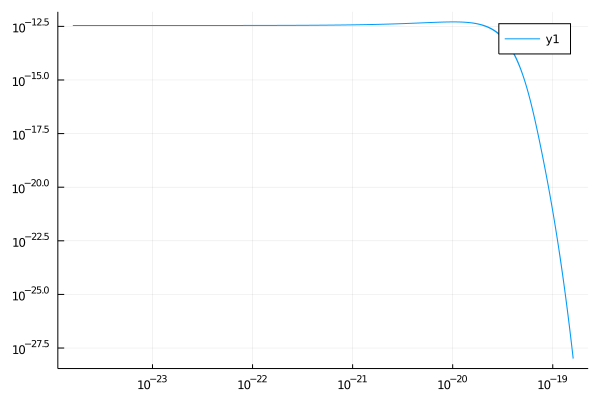

In [4]:
plot(range, res, xaxis=:log, yaxis=:log)

Both axis are logarithmic, but we see that $k$ reaches a maximum value for low $\omega_\alpha$.

Now we will investigate the influence of $\sigma$.

In [5]:
semiconductor.ModeEffect = 0.1 * 1.6e-19;

function test_omega_sigma(range)
    res = [];
    for i in range
        semiconductor.SigmaI = (T -> i * Conduction.k * T);
        append!(res, kp_lower_limit(semiconductor, T, 8.01e-21 / (Conduction.k * T)));
    end

    return res
end

range = (1:0.1:10);
res = test_omega_sigma(range);

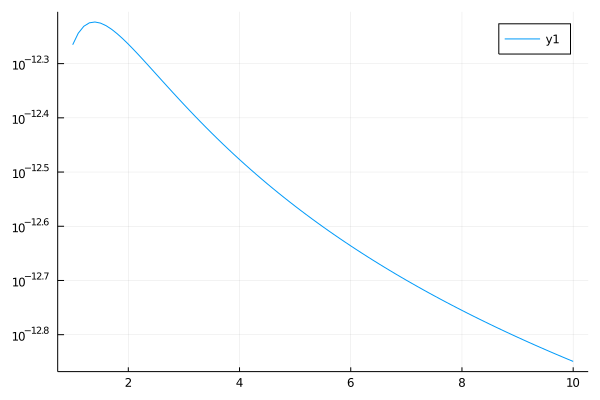

In [6]:
plot(range, res, yaxis=:log)

Here again, we see that there is a maximum in the $k$ value.

Both variations didn't yield enough changes in the final $k$ value to be the source of the low numericals.

Now we will investigate the influence of logarithmic gaussian DOS with a lower limit of $0.05eV$ and an upper limit of $0.62eV$.

In [7]:
quadgk(
    r -> Conduction.k * T * Conduction.DOSp2(semiconductor, r, T) * Conduction.C(r, T) * Conduction.Dp(semiconductor, r, T),
    8.01e-21 / (Conduction.k * T),
    9.93e-20 / (Conduction.k * T)
)[1]

1.430815594382179e-13

The value returned is simialar in order of magnitude as the one with the classic gaussian DOS.

In [8]:
semiconductor = Conduction.Semiconductor(
4.34e7, # decay constant of the assumed hydrogen-like localized state wave functions (cm^-1)
0.1 * 1.6e-19, # Mode effect of the phonons (J)
3e21, # intrinsic semiconductor's density (cm^-3)
0, # Doping states' density (cm^-3)
0.1 * 1.6e-19, # Energy to a vacant target site (J)
-5.3e4, # Field (V.cm^-1)
1e13, # Base electron jump rate
-27, # Fermi level (J)
2.74, # Intrinsic semiconductor's gaussian width (J)
2.7, # Doping states' gaussian width (J)
2.7, # Amount of disorder
150e-7
);


kp_log(semiconductor, T) = quadgk(
    r -> Conduction.k * T * Conduction.DOSp2(semiconductor, r, T) * Conduction.C(r, T) * Conduction.Dp(semiconductor, r, T),
    8.01e-21 / (Conduction.k * T),
    9.93e-20 / (Conduction.k * T)
)[1];

function test_omega_alpha(range)
    res = [];
    for i in range
        semiconductor.ModeEffect = i;
        append!(res, kp_log(semiconductor, T));
    end

    return res
end

range = (0.00001:0.00001:1) * 1.6e-19;
res = test_omega_alpha(range);

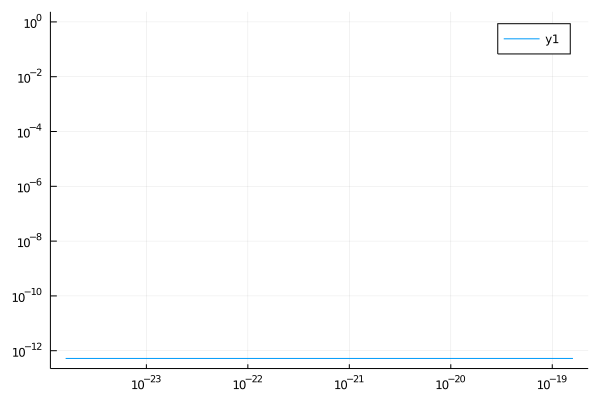

In [9]:
plot(range, res, xaxis=:log, yaxis=:log)

In [10]:
semiconductor.ModeEffect = 0.1 * 1.6e-19;

function test_omega_sigma(range)
    res = [];
    for i in range
        semiconductor.SigmaI = (T -> i * Conduction.k * T);
        append!(res, kp_log(semiconductor, T));
    end

    return res
end

range = (0.00001:0.00001:10);
res = test_omega_sigma(range);

In [11]:
plot(range, res, yaxis=:log, xaxis=:log)

It seems that the relation with $\sigma$ is logarithmic.

We will perform the same type of computation with the lower limit set to $0.001eV$ for the logarithmic DOS.

In [12]:
semiconductor = Conduction.Semiconductor(
4.34e7, # decay constant of the assumed hydrogen-like localized state wave functions (cm^-1)
0.1 * 1.6e-19, # Mode effect of the phonons (J)
3e21, # intrinsic semiconductor's density (cm^-3)
0, # Doping states' density (cm^-3)
0.1 * 1.6e-19, # Energy to a vacant target site (J)
-5.3e4, # Field (V.cm^-1)
1e13, # Base electron jump rate
-27, # Fermi level (J)
2.74, # Intrinsic semiconductor's gaussian width (J)
2.7, # Doping states' gaussian width (J)
2.7, # Amount of disorder
150e-7
);

kp_log(semiconductor, T) = quadgk(
    r -> Conduction.k * T * Conduction.DOSp2(semiconductor, r, T) * Conduction.C(r, T) * Conduction.Dp(semiconductor, r, T),
    1.602e-22 / (Conduction.k * T),
    9.93e-20 / (Conduction.k * T)
)[1];

kp_log(semiconductor, T)

1.1680645119534064e-7

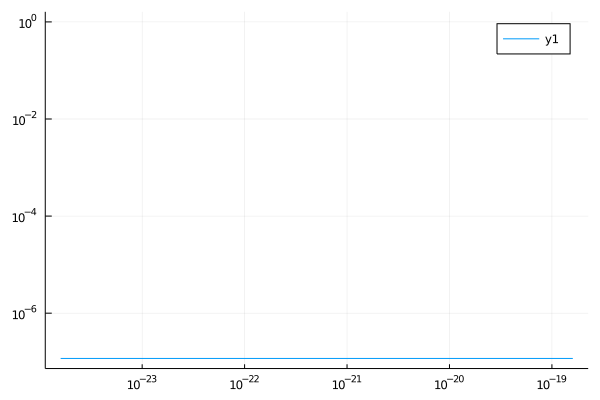

In [13]:
function test_omega_alpha(range)
    res = [];
    for i in range
        semiconductor.ModeEffect = i;
        append!(res, kp_log(semiconductor, T));
    end

    return res
end

range = (0.00001:0.00001:1) * 1.6e-19;
res = test_omega_alpha(range);
plot(range, res, xaxis=:log, yaxis=:log)

In [14]:
semiconductor.ModeEffect = 0.1 * 1.6e-19;

function test_omega_sigma(range)
    res = [];
    for i in range
        semiconductor.SigmaI = (T -> i * Conduction.k * T);
        append!(res, kp_log(semiconductor, T));
    end

    return res
end

range = (0.00001:0.00001:10);
res = test_omega_sigma(range);

plot(range, res, yaxis=:log, xaxis=:log)

Here again, $\sigma$ changes significantly the results but not until acceptable range.

In [16]:
D = 4.10e-6;

semiconductor = Conduction.Semiconductor(
4.34e7, # decay constant of the assumed hydrogen-like localized state wave functions (cm^-1)
0.1 * 1.6e-19, # Mode effect of the phonons (J)
3e21, # intrinsic semiconductor's density (cm^-3)
0, # Doping states' density (cm^-3)
0.1 * 1.6e-19, # Energy to a vacant target site (J)
-5.3e4, # Field (V.cm^-1)
1e13, # Base electron jump rate
-27, # Fermi level (J)
2.74, # Intrinsic semiconductor's gaussian width (J)
2.7, # Doping states' gaussian width (J)
2.7, # Amount of disorder
150e-7
);


kp(semiconductor, T) = quadgk(
    r -> Conduction.k * T * Conduction.DOSp(semiconductor, r, T) * Conduction.C(r, T) * D,
    7.95e-21 / (Conduction.k * T),
    7.95e-20 / (Conduction.k * T)
)[1];

kp(semiconductor, T)

0.033635944708678145